In [2]:
import pydub
import scipy.io.wavfile

In [3]:
import sys
sys.path.append('../')

In [4]:
from config import FILES

In [5]:
from make_training_data import _mp3_hook, _read_wav
def read_audio(file):
    f = _mp3_hook(file) if file.endswith('.mp3') else file
    return _read_wav(f)

In [6]:
def make_features(audio, sr, clip_begin, window_length, nfft):
    clip = audio[clip_begin:clip_begin+window_length]
    f, t, S = scipy.signal.spectrogram(clip, sr, nfft=nfft)
    S_mean = S.mean(axis=1)
    min_S_mean, max_S_mean = S_mean.min(), S_mean.max()
    # be careful to handle divide by zero errors here                   
    if min_S_mean != max_S_mean:
        features = (S_mean - min_S_mean) / (max_S_mean - min_S_mean)
    elif max_S_mean != 0:
        features = S_mean / max_S_mean
    else:
        features = S_mean
    return features

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline
def examine_features(X):
    print('< 0.1:', sum(X < 0.1))
    print('>= 0.1:', sum(X >= 0.1))
    plt.plot(X)

In [8]:
import random

/home/dante_gates/music/Music/Music/F30/06 Seen .mp3
< 0.1: 1900
>= 0.1: 149


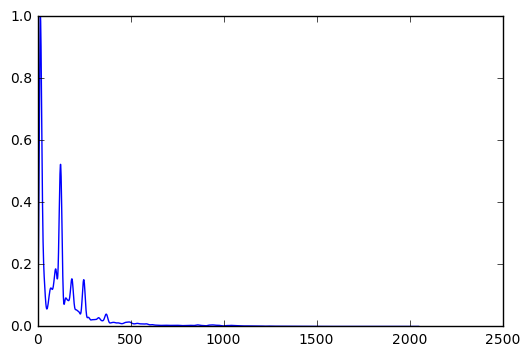

In [9]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)

/home/dante_gates/music/Music/Music/F72/02 Tell .mp3
< 0.1: 1992
>= 0.1: 57


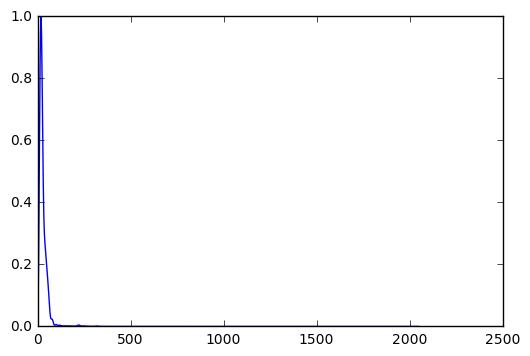

In [10]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

/home/dante_gates/music/Music/Music/F44/09 Lucky.mp3
< 0.1: 1998
>= 0.1: 51


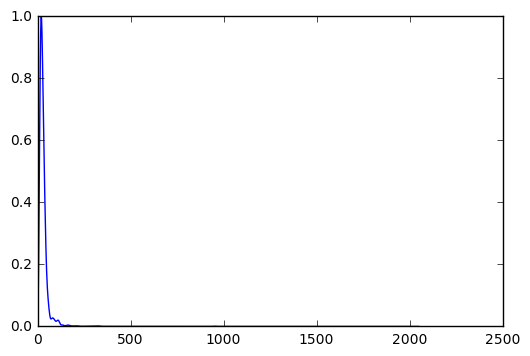

In [11]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

/home/dante_gates/music/Music/Music/F39/05 One B.mp3
< 0.1: 1946
>= 0.1: 103


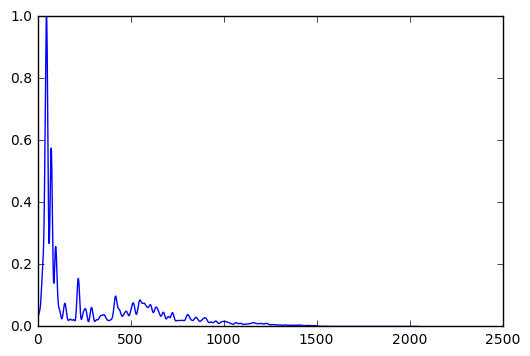

In [12]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

/home/dante_gates/music/Music/Music/F33/02 You O.mp3
< 0.1: 1969
>= 0.1: 80


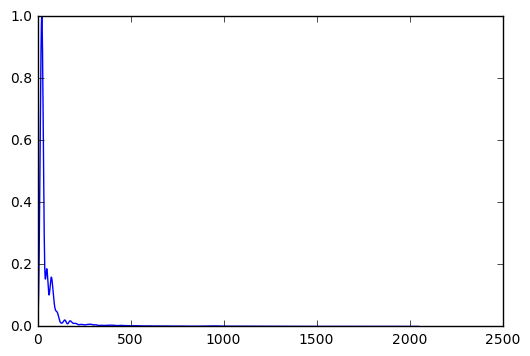

In [13]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

/home/dante_gates/music/Music/Music/F63/16 Do Wh.mp3
< 0.1: 2013
>= 0.1: 36


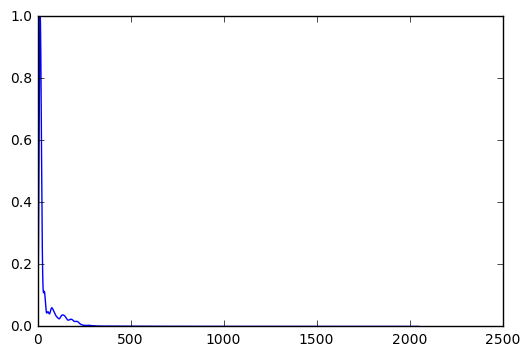

In [14]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

/home/dante_gates/music/Music/Music/F36/01 Godzi.mp3
< 0.1: 1993
>= 0.1: 56


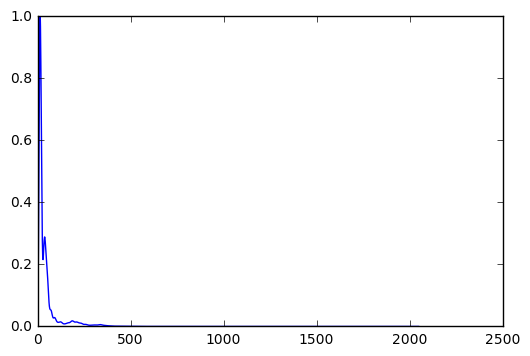

In [15]:
f = random.choice(FILES)
print(f)
sr, audio = read_audio(f)
X = make_features(audio, sr, clip_begin=0, window_length=8*sr, nfft=2**12)
examine_features(X)
pydub.AudioSegment.from_mp3(f)[:sr*8]

In [51]:
import numpy as np
f, t, Sxx = scipy.signal.spectrogram(np.random.uniform(size=44100), 44100, nfft=2**12)

In [52]:
start, stop = abs(f - 20).argmin(), abs(f - 2000).argmin()
print(start, stop)

2 186


In [53]:
print(sum(X[start:stop] < 0.1))
print(sum(X[start:stop] >= 0.1))

128
56


In [50]:
np.random.uniform((44100,))

array([ 6322.82896897])